# Safety Compliance System: Glove Detection

## Project Overview
This notebook implements a safety compliance system that detects whether workers are wearing gloves using YOLOv5.

**Classes:**
- `gloves` (gloved hand)
- `no-gloves` (bare hand)

**Dataset:** Roboflow Universe - YOLOv5 PyTorch format
- Train: 6161 images (87%)
- Valid: 475 images (7%)
- Test: 473 images (7%)

## 1. Setup and Installation

In [1]:
# Install required packages
!pip uninstall torch torchvision torchaudio -y
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip install ultralytics opencv-python pillow matplotlib numpy pyyaml
!pip install ipywidgets tqdm

Looking in indexes: https://download.pytorch.org/whl/cu121
     ---------------------------------------- 0.0/2.4 GB ? eta -:--:--
     ---------------------------------------- 0.0/2.4 GB 9.6 MB/s eta 0:04:15
     ---------------------------------------- 0.0/2.4 GB 7.2 MB/s eta 0:05:41
     ---------------------------------------- 0.0/2.4 GB 7.4 MB/s eta 0:05:31
     ---------------------------------------- 0.0/2.4 GB 7.3 MB/s eta 0:05:33
     ---------------------------------------- 0.0/2.4 GB 7.8 MB/s eta 0:05:13
     ---------------------------------------- 0.0/2.4 GB 7.4 MB/s eta 0:05:31
     ---------------------------------------- 0.0/2.4 GB 7.1 MB/s eta 0:05:42
     ---------------------------------------- 0.0/2.4 GB 7.6 MB/s eta 0:05:23
     ---------------------------------------- 0.0/2.4 GB 7.2 MB/s eta 0:05:38
     ---------------------------------------- 0.0/2.4 GB 7.3 MB/s eta 0:05:33
     ---------------------------------------- 0.0/2.4 GB 7.2 MB/s eta 0:05:36
     -------

In [1]:
# Import libraries
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import yaml
import shutil
from tqdm import tqdm
import torch

print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA version: {torch.version.cuda}")
    print(f"GPU: {torch.cuda.get_device_name(0)}")

PyTorch version: 2.5.1+cu121
CUDA available: True
CUDA version: 12.1
GPU: NVIDIA GeForce RTX 3050 6GB Laptop GPU


## 2. Dataset Setup

**Important:** Update the `DATASET_PATH` variable below to point to your downloaded dataset folder.

In [3]:
# Configure paths - UPDATE THIS PATH TO YOUR DATASET LOCATION
#DATASET_PATH = r"C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch"  # Change this!
dataset_path = Path(r"C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch").resolve()

# Verify dataset structure
#dataset_path = Path(DATASET_PATH)

print("Dataset structure:")
for split in ['train', 'valid', 'test']:
    split_path = dataset_path / split
    if split_path.exists():
        images = list((split_path / 'images').glob('*.jpg')) + list((split_path / 'images').glob('*.png'))
        labels = list((split_path / 'labels').glob('*.txt'))
        print(f"  {split}: {len(images)} images, {len(labels)} labels")
    else:
        print(f"  {split}: NOT FOUND")

# Check for data.yaml
data_yaml_path = dataset_path / 'data.yaml'
if data_yaml_path.exists():
    print("\ndata.yaml found ✓")
    with open(data_yaml_path, 'r') as f:
        data_config = yaml.safe_load(f)
        print(f"Classes: {data_config.get('names', [])}")
else:
    print("\ndata.yaml NOT FOUND - will create one")

Dataset structure:
  train: 6161 images, 6161 labels
  valid: 475 images, 475 labels
  test: 473 images, 473 labels

data.yaml found ✓
Classes: ['gloves', 'no-gloves']


### Create/Verify data.yaml Configuration

In [4]:
# Create data.yaml if it doesn't exist
data_yaml_content = f"""train: C:\\Users\\A\\Documents\\Project\\GloveDetectionSystem\\Glove.v2i.yolov5pytorch\\train\\images
val: C:\\Users\\A\\Documents\\Project\\GloveDetectionSystem\\Glove.v2i.yolov5pytorch\\valid\\images
test: C:\\Users\\A\\Documents\\Project\\GloveDetectionSystem\\Glove.v2i.yolov5pytorch\\test\\images

nc: 2
names: ['gloves', 'no-gloves']
"""

#if not data_yaml_path.exists():
with open(data_yaml_path, 'w') as f:
        f.write(data_yaml_content)
print("Created data.yaml")
#else:
print("data.yaml already exists")

print("\nCurrent data.yaml content:")
with open(data_yaml_path, 'r') as f:
    print(f.read())

Created data.yaml
data.yaml already exists

Current data.yaml content:
train: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\train\images
val: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\valid\images
test: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\test\images

nc: 2
names: ['gloves', 'no-gloves']



In [5]:
with open(r"C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\data.yaml", 'r') as f:
    print(f.read())

train: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\train\images
val: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\valid\images
test: C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\test\images

nc: 2
names: ['gloves', 'no-gloves']



### Visualize Sample Annotations

Sample Training Images with Annotations:


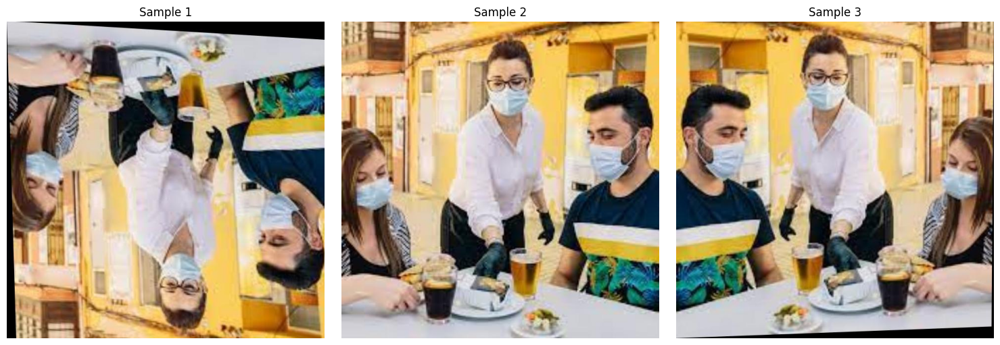

In [6]:
def visualize_sample(dataset_path, split='train', num_samples=3):
    """Visualize sample images with annotations"""
    images_path = dataset_path / split / 'images'
    labels_path = dataset_path / split / 'labels'
    
    image_files = list(images_path.glob('*.jpg'))[:num_samples]
    
    class_names = ['gloves', 'no-gloves']
    colors = [(0, 255, 0), (255, 0, 0)]  # Green for gloves, Red for no-gloves
    
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))
    if num_samples == 1:
        axes = [axes]
    
    for idx, img_path in enumerate(image_files):
        # Read image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]
        
        # Read corresponding label
        label_path = labels_path / f"{img_path.stem}.txt"
        
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f.readlines():
                    # Parse YOLO format: class x_center y_center width height
                    parts = line.strip().split()
                    if len(parts) == 5:
                        cls, x_c, y_c, width, height = map(float, parts)
                        cls = int(cls)
                        
                        # Convert to pixel coordinates
                        x1 = int((x_c - width/2) * w)
                        y1 = int((y_c - height/2) * h)
                        x2 = int((x_c + width/2) * w)
                        y2 = int((y_c + height/2) * h)
                        
                        # Draw box
                        color = colors[cls]
                        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
                        
                        # Add label
                        label_text = class_names[cls]
                        cv2.putText(img, label_text, (x1, y1-10),
                                  cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
        
        axes[idx].imshow(img)
        axes[idx].axis('off')
        axes[idx].set_title(f"Sample {idx+1}")
    
    plt.tight_layout()
    plt.show()

# Visualize samples
print("Sample Training Images with Annotations:")
visualize_sample(dataset_path, 'train', num_samples=3)

## 3. Model Training

We'll use YOLOv5 for training. You can choose different model sizes:
- `yolov5n.pt` - Nano (fastest, least accurate)
- `yolov5s.pt` - Small (balanced)
- `yolov5m.pt` - Medium (good accuracy)
- `yolov5l.pt` - Large (best accuracy, slowest)

In [7]:
# Clone YOLOv5 repository if not exists
if not Path('yolov5').exists():
    !git clone https://github.com/ultralytics/yolov5
    print("YOLOv5 repository cloned")
else:
    print("YOLOv5 repository already exists")

# Install requirements
%cd yolov5
!pip install -r requirements.txt
%cd ..

YOLOv5 repository already exists
c:\Users\A\Documents\Project\GloveDetectionSystem\yolov5
c:\Users\A\Documents\Project\GloveDetectionSystem


In [ ]:
# Training configuration
MODEL_SIZE = 'yolov5n'  # Change to yolov5n, yolov5m, yolov5l for different sizes
EPOCHS = 50  # Increase for better results 
BATCH_SIZE = 8  
IMG_SIZE = 416

# Create runs directory
runs_dir = Path('runs')
runs_dir.mkdir(exist_ok=True)

print(f"Training Configuration:")
print(f"  Model: {MODEL_SIZE}")
print(f"  Epochs: {EPOCHS}")
print(f"  Batch Size: {BATCH_SIZE}")
print(f"  Image Size: {IMG_SIZE}")

Training Configuration:
  Model: yolov5n
  Epochs: 50
  Batch Size: 8
  Image Size: 416


In [9]:
# Start training
!python yolov5/train.py \
    --img {IMG_SIZE} \
    --batch {BATCH_SIZE} \
    --epochs {EPOCHS} \
    --data "{data_yaml_path}" \
    --weights {MODEL_SIZE}.pt \
    --project runs/glove_detection \
    --name exp \
    --workers 4 \
    --device 0

github: skipping check (offline), for updates see https://github.com/ultralytics/yolov5


train: weights=yolov5n.pt, cfg=, data=C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\data.yaml, hyp=yolov5\data\hyps\hyp.scratch-low.yaml, epochs=50, batch_size=8, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=yolov5\data\hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=4, project=runs/glove_detection, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
YOLOv5  v7.0-450-g781b9d57 Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=

      49/49     0.428G    0.03133    0.01216  0.0006013         16        416:  47%|████▋     | 360/770 [00:30<00:33, 12.25it/s]c:\Users\A\Documents\Project\GloveDetectionSystem\yolov5\train.py:414: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):

      49/49     0.428G    0.03132    0.01216     0.0006         25        416:  47%|████▋     | 360/770 [00:30<00:33, 12.25it/s]c:\Users\A\Documents\Project\GloveDetectionSystem\yolov5\train.py:414: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):

      49/49     0.428G    0.03132    0.01215  0.0005985         21        416:  47%|████▋     | 360/770 [00:30<00:33, 12.25it/s]
      49/49     0.428G    0.03132    0.01215  0.0005985         21        416:  47%|████▋     | 362/770 [00:30<00:33, 12.23it/s]c:\Users\A\Documents\Pr

### Visualize Training Results

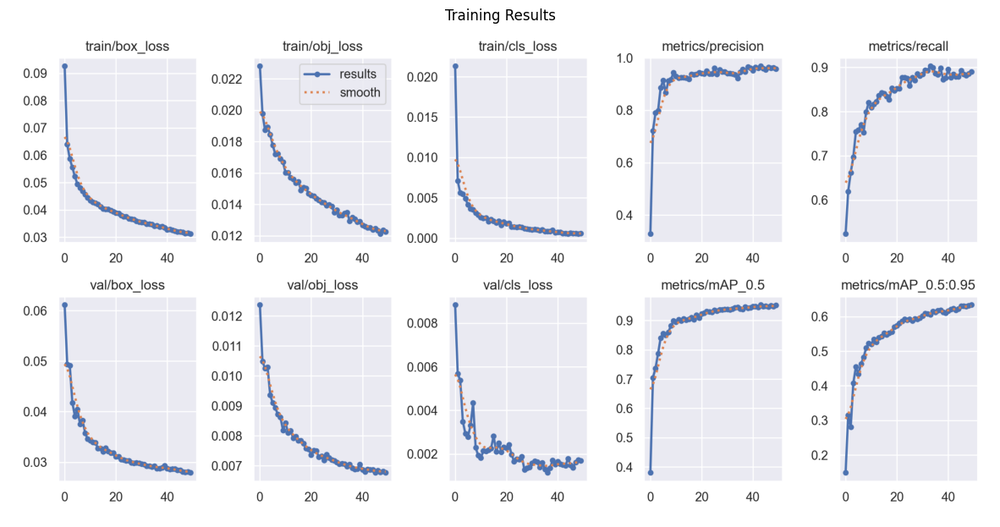

In [10]:
# Display training results
results_path = Path('runs/glove_detection/exp')

if (results_path / 'results.png').exists():
    img = Image.open(results_path / 'results.png')
    plt.figure(figsize=(15, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title('Training Results')
    plt.show()
else:
    print("Training results not found. Please check if training completed successfully.")

## 4. Model Evaluation

In [11]:
# Run validation on test set
best_weights = results_path / 'weights' / 'best.pt'

if best_weights.exists():
    !python yolov5/val.py \
        --weights {best_weights} \
        --data {data_yaml_path} \
        --img {IMG_SIZE} \
        --task test \
        --project runs/glove_detection \
        --name val \
        --device 0
else:
    print("Best weights not found. Please ensure training completed successfully.")

val: data=C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\data.yaml, weights=['runs\\glove_detection\\exp\\weights\\best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/glove_detection, name=val, exist_ok=False, half=False, dnn=False
YOLOv5  v7.0-450-g781b9d57 Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)

Fusing layers... 
Model summary: 157 layers, 1761871 parameters, 0 gradients, 4.1 GFLOPs

test: Scanning C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\test\labels...:   0%|          | 0/473 [00:00<?, ?it/s]
test: Scanning C:\Users\A\Documents\Project\GloveDetectionSystem\Glove.v2i.yolov5pytorch\test\labels... 1 images, 0 backgrounds, 0 corrupt:   0%|          | 1/473 [00:07<55:24,  7.04s/it]
test: S

## 5. Detection Script

Now we'll create the detection pipeline that:
1. Takes a folder of images
2. Runs detection
3. Saves annotated images
4. Creates JSON logs

In [12]:
from ultralytics import YOLO
import torch

class GloveDetector:
    def __init__(self, weights_path, confidence_threshold=0.25):
        """
        Initialize the glove detector
        
        Args:
            weights_path: Path to trained model weights
            confidence_threshold: Minimum confidence for detections
        """
        self.model = YOLO(weights_path)
        self.confidence_threshold = confidence_threshold
        self.class_names = ['gloves', 'no-gloves']
        # Map internal class names to required output format
        self.label_mapping = {
            'gloves': 'gloved_hand',
            'no-gloves': 'bare_hand'
        }
        print(f"Model loaded from {weights_path}")
        print(f"Confidence threshold: {confidence_threshold}")
    
    def detect(self, image_path):
        """
        Run detection on a single image
        
        Args:
            image_path: Path to input image
            
        Returns:
            detections: List of detection dictionaries
            annotated_image: Image with bounding boxes drawn
        """
        # Run inference
        results = self.model(image_path, conf=self.confidence_threshold)
        
        # Read original image
        img = cv2.imread(str(image_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        detections = []
        
        # Process results
        for result in results:
            boxes = result.boxes
            
            for box in boxes:
                # Extract box coordinates
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                confidence = float(box.conf[0].cpu().numpy())
                class_id = int(box.cls[0].cpu().numpy())
                
                # Get class name and map to required format
                class_name = self.class_names[class_id]
                output_label = self.label_mapping[class_name]
                
                # Store detection
                detection = {
                    "label": output_label,
                    "confidence": round(confidence, 3),
                    "bbox": [int(x1), int(y1), int(x2), int(y2)]
                }
                detections.append(detection)
                
                # Draw on image
                color = (0, 255, 0) if output_label == 'gloved_hand' else (255, 0, 0)
                cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), color, 2)
                
                # Add label with confidence
                label_text = f"{output_label}: {confidence:.2f}"
                cv2.putText(img, label_text, (int(x1), int(y1)-10),
                          cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
        
        return detections, img
    
    def process_folder(self, input_folder, output_folder, logs_folder):
        """
        Process all images in a folder
        
        Args:
            input_folder: Path to input images
            output_folder: Path to save annotated images
            logs_folder: Path to save JSON logs
        """
        # Create output directories
        output_path = Path(output_folder)
        logs_path = Path(logs_folder)
        output_path.mkdir(parents=True, exist_ok=True)
        logs_path.mkdir(parents=True, exist_ok=True)
        
        # Get all image files
        input_path = Path(input_folder)
        image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']
        image_files = []
        for ext in image_extensions:
            image_files.extend(list(input_path.glob(ext)))
        
        print(f"Found {len(image_files)} images to process")
        
        # Process each image
        for img_path in tqdm(image_files, desc="Processing images"):
            try:
                # Run detection
                detections, annotated_img = self.detect(img_path)
                
                # Save annotated image
                output_img_path = output_path / img_path.name
                annotated_img_bgr = cv2.cvtColor(annotated_img, cv2.COLOR_RGB2BGR)
                cv2.imwrite(str(output_img_path), annotated_img_bgr)
                
                # Save JSON log
                log_data = {
                    "filename": img_path.name,
                    "detections": detections
                }
                
                log_path = logs_path / f"{img_path.stem}.json"
                with open(log_path, 'w') as f:
                    json.dump(log_data, f, indent=2)
                
            except Exception as e:
                print(f"Error processing {img_path.name}: {e}")
        
        print(f"\nProcessing complete!")
        print(f"Annotated images saved to: {output_path}")
        print(f"JSON logs saved to: {logs_path}")
        
        return output_path, logs_path

In [20]:
class GloveDetector:
    def __init__(self, weights_path, confidence_threshold=0.25):
        self.model = torch.hub.load('ultralytics/yolov5', 'custom', path=weights_path)
        self.model.conf = confidence_threshold
        self.class_names = ['gloves', 'no-gloves']
        self.label_mapping = {
            'gloves': 'gloved_hand',
            'no-gloves': 'bare_hand'
        }
        print(f"Model loaded from {weights_path}")
        print(f"Confidence threshold: {confidence_threshold}")
    
    def detect(self, image_path):
        results = self.model(image_path)
        img = cv2.imread(str(image_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        detections = []
        
        for *xyxy, conf, cls in results.xyxy[0]:
            x1, y1, x2, y2 = [int(x) for x in xyxy]
            confidence = float(conf)
            class_id = int(cls)
            
            class_name = self.class_names[class_id]
            output_label = self.label_mapping[class_name]
            
            detection = {
                "label": output_label,
                "confidence": round(confidence, 3),
                "bbox": [x1, y1, x2, y2]
            }
            detections.append(detection)
            
            color = (0, 255, 0) if output_label == 'gloved_hand' else (255, 0, 0)
            cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
            label_text = f"{output_label}: {confidence:.2f}"
            cv2.putText(img, label_text, (x1, y1-10),
                      cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
        
        return detections, img
    
    def process_folder(self, input_folder, output_folder, logs_folder):
        output_path = Path(output_folder)
        logs_path = Path(logs_folder)
        output_path.mkdir(parents=True, exist_ok=True)
        logs_path.mkdir(parents=True, exist_ok=True)
        
        input_path = Path(input_folder)
        image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']
        image_files = []
        for ext in image_extensions:
            image_files.extend(list(input_path.glob(ext)))
        
        print(f"Found {len(image_files)} images to process")
        
        for img_path in tqdm(image_files, desc="Processing images"):
            try:
                detections, annotated_img = self.detect(img_path)
                
                output_img_path = output_path / img_path.name
                annotated_img_bgr = cv2.cvtColor(annotated_img, cv2.COLOR_RGB2BGR)
                cv2.imwrite(str(output_img_path), annotated_img_bgr)
                
                log_data = {
                    "filename": img_path.name,
                    "detections": detections
                }
                
                log_path = logs_path / f"{img_path.stem}.json"
                with open(log_path, 'w') as f:
                    json.dump(log_data, f, indent=2)
                
            except Exception as e:
                print(f"Error processing {img_path.name}: {e}")
        
        print(f"\nProcessing complete!")
        print(f"Annotated images saved to: {output_path}")
        print(f"JSON logs saved to: {logs_path}")
        
        return output_path, logs_path

### Initialize Detector and Test

In [21]:
# Initialize detector with best weights
best_weights = 'runs/glove_detection/exp/weights/best.pt'

if not Path(best_weights).exists():
    print("WARNING: Best weights not found!")
    print("Please ensure training completed successfully.")
    print(f"Looking for weights at: {best_weights}")
else:
    detector = GloveDetector(
    weights_path='runs/glove_detection/exp/weights/best.pt',
    confidence_threshold=0.25)

Using cache found in C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-11-28 Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)

Fusing layers... 
Model summary: 157 layers, 1761871 parameters, 0 gradients, 4.1 GFLOPs
Adding AutoShape... 


Model loaded from runs/glove_detection/exp/weights/best.pt
Confidence threshold: 0.25


### Test on Sample Images from Test Set

In [22]:
# Test on a few images from test set
test_images_path = dataset_path / 'test' / 'images'
sample_images = list(test_images_path.glob('*.jpg'))[:5]

print(f"Testing on {len(sample_images)} sample images\n")

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for idx, img_path in enumerate(sample_images):
    detections, annotated_img = detector.detect(img_path)
    
    axes[idx].imshow(annotated_img)
    axes[idx].axis('off')
    axes[idx].set_title(f"{img_path.name}\n{len(detections)} detections")
    
    # Print detection details
    print(f"\n{img_path.name}:")
    for det in detections:
        print(f"  - {det['label']}: {det['confidence']:.3f}")

# Hide extra subplot
axes[5].axis('off')

plt.tight_layout()
plt.show()

Testing on 5 sample images


IMG_5719_14-32sec_jpg.rf.63fe2c153b40a5ac2b6add993e3c53ae.jpg:
  - bare_hand: 0.940
  - bare_hand: 0.930

IMG_5719_15-32sec_jpg.rf.326668a0106e934dcee9689b263a4ae0.jpg:
  - bare_hand: 0.954
  - bare_hand: 0.944

IMG_5719_17-32sec_jpg.rf.b3cae7bf26ca7b0670214472d3b4fd1f.jpg:
  - bare_hand: 0.942
  - bare_hand: 0.920


C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):



IMG_5719_18-32sec_jpg.rf.f9b6f8cf8ef5990bc8a02df238cdff97.jpg:
  - bare_hand: 0.915
  - bare_hand: 0.884

IMG_5719_19-32sec_jpg.rf.427fbd9dd0ca837aad9afa78c4144a14.jpg:
  - bare_hand: 0.901
  - bare_hand: 0.820


C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


## 6. Process Full Test Set and Create Submission

In [23]:
# Create submission structure
submission_dir = Path('submission/Part_1_Glove_Detection')
submission_dir.mkdir(parents=True, exist_ok=True)

# Process test images
input_folder = dataset_path / 'test' / 'images'
output_folder = submission_dir / 'output'
logs_folder = submission_dir / 'logs'

print("Processing test set...\n")
output_path, logs_path = detector.process_folder(  
    input_folder=input_folder,
    output_folder=output_folder,
    logs_folder=logs_folder
)

Processing test set...

Found 946 images to process


Processing images:   0%|          | 0/946 [00:00<?, ?it/s]C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
Processing images:   0%|          | 2/946 [00:00<00:57, 16.34it/s]C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\A/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:898: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args..


Processing complete!
Annotated images saved to: submission\Part_1_Glove_Detection\output
JSON logs saved to: submission\Part_1_Glove_Detection\logs


### Display Sample Results

In [24]:
# Display some results with their JSON logs
output_images = list(output_path.glob('*.jpg'))[:5]

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for idx, img_path in enumerate(output_images):
    # Load and display image
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    axes[idx].imshow(img)
    axes[idx].axis('off')
    axes[idx].set_title(img_path.name)
    
    # Load and print JSON
    json_path = logs_path / f"{img_path.stem}.json"
    if json_path.exists():
        with open(json_path, 'r') as f:
            log_data = json.load(f)
        print(f"\n{img_path.name}:")
        print(json.dumps(log_data, indent=2))

axes[5].axis('off')
plt.tight_layout()
plt.show()


IMG_5719_14-32sec_jpg.rf.63fe2c153b40a5ac2b6add993e3c53ae.jpg:
{
  "filename": "IMG_5719_14-32sec_jpg.rf.63fe2c153b40a5ac2b6add993e3c53ae.jpg",
  "detections": [
    {
      "label": "bare_hand",
      "confidence": 0.94,
      "bbox": [
        364,
        204,
        419,
        267
      ]
    },
    {
      "label": "bare_hand",
      "confidence": 0.93,
      "bbox": [
        215,
        216,
        265,
        273
      ]
    }
  ]
}

IMG_5719_15-32sec_jpg.rf.326668a0106e934dcee9689b263a4ae0.jpg:
{
  "filename": "IMG_5719_15-32sec_jpg.rf.326668a0106e934dcee9689b263a4ae0.jpg",
  "detections": [
    {
      "label": "bare_hand",
      "confidence": 0.954,
      "bbox": [
        290,
        200,
        326,
        255
      ]
    },
    {
      "label": "bare_hand",
      "confidence": 0.944,
      "bbox": [
        428,
        192,
        465,
        251
      ]
    }
  ]
}

IMG_5719_17-32sec_jpg.rf.b3cae7bf26ca7b0670214472d3b4fd1f.jpg:
{
  "filename": "IMG_5719_17-3

## 7. Generate Statistics and Summary

In [25]:
# Analyze detection results
json_files = list(logs_path.glob('*.json'))

total_images = len(json_files)
total_gloved = 0
total_bare = 0
total_detections = 0
confidence_scores = {'gloved_hand': [], 'bare_hand': []}

for json_file in json_files:
    with open(json_file, 'r') as f:
        data = json.load(f)
        for det in data['detections']:
            total_detections += 1
            if det['label'] == 'gloved_hand':
                total_gloved += 1
            else:
                total_bare += 1
            confidence_scores[det['label']].append(det['confidence'])

print("=" * 60)
print("DETECTION SUMMARY")
print("=" * 60)
print(f"Total images processed: {total_images}")
print(f"Total detections: {total_detections}")
print(f"\nDetection breakdown:")
print(f"  - Gloved hands: {total_gloved} ({total_gloved/total_detections*100:.1f}%)")
print(f"  - Bare hands: {total_bare} ({total_bare/total_detections*100:.1f}%)")
print(f"\nAverage confidence scores:")
if confidence_scores['gloved_hand']:
    print(f"  - Gloved hands: {np.mean(confidence_scores['gloved_hand']):.3f}")
if confidence_scores['bare_hand']:
    print(f"  - Bare hands: {np.mean(confidence_scores['bare_hand']):.3f}")
print("=" * 60)

# Plot confidence distribution
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

if confidence_scores['gloved_hand']:
    axes[0].hist(confidence_scores['gloved_hand'], bins=20, color='green', alpha=0.7)
    axes[0].set_title('Gloved Hand Confidence Distribution')
    axes[0].set_xlabel('Confidence')
    axes[0].set_ylabel('Count')

if confidence_scores['bare_hand']:
    axes[1].hist(confidence_scores['bare_hand'], bins=20, color='red', alpha=0.7)
    axes[1].set_title('Bare Hand Confidence Distribution')
    axes[1].set_xlabel('Confidence')
    axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

DETECTION SUMMARY
Total images processed: 473
Total detections: 1059

Detection breakdown:
  - Gloved hands: 330 (31.2%)
  - Bare hands: 729 (68.8%)

Average confidence scores:
  - Gloved hands: 0.741
  - Bare hands: 0.731
